In [1]:
import os
print(os.getcwd())
#os.chdir('..')
os.chdir('d:/Users/mokky/Documents/GitHub/NUS-ISS/IS02_PT_Capstone_Human_Re-ID')
print(os.getcwd())

d:\Users\mokky\Documents\GitHub\NUS-ISS\IS02_PT_Capstone_Human_Re-ID\notebooks
d:\Users\mokky\Documents\GitHub\NUS-ISS\IS02_PT_Capstone_Human_Re-ID


In [108]:
import sqlite3
from src.database.database import DbQuery
import pandas as pd
import matplotlib.pyplot as plt
import cv2
import numpy as np
import io
import base64
import math

In [3]:
imagedb = DbQuery('database/Image.db')

print(imagedb.table_name)


None


In [23]:
db_path = 'database/Image.db'
query = "SELECT name FROM sqlite_master WHERE type='table'"
conn = sqlite3.connect(db_path, detect_types=sqlite3.PARSE_DECLTYPES |
                       sqlite3.PARSE_COLNAMES)
cursor = conn.cursor()
cursor.execute(query)
column_names = [desc[0] for desc in cursor.description]
qry_results = pd.DataFrame(cursor.fetchall(), columns=column_names)
print(qry_results)


              name
0   VectorKB_Table
1  Inference_Table


<class 'numpy.ndarray'>


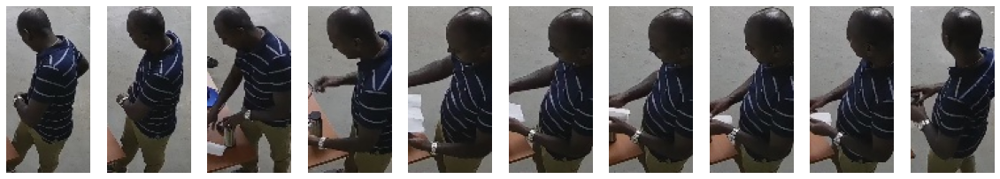

In [102]:
db_path = 'database/Image.db'
table_name = 'VectorKB_Table'
query = f'SELECT * FROM {table_name} ORDER BY cam_id, img_id LIMIT 10'
conn = sqlite3.connect(db_path, detect_types=sqlite3.PARSE_DECLTYPES |
                            sqlite3.PARSE_COLNAMES)
cursor = conn.cursor()
cursor.execute(query)
column_names = [desc[0] for desc in cursor.description]
qry_results = pd.DataFrame(cursor.fetchall(), columns=column_names)
#print(qry_results)
img = cv2.imdecode(np.frombuffer(
    qry_results['patch_img'].iloc[0], np.uint8), cv2.IMREAD_ANYCOLOR)
print(type(img))
fig, axs = plt.subplots(1, len(qry_results), figsize=(20, 15))
for i in range(len(qry_results)):
    img_data = qry_results['patch_img'].iloc[i]
    img = cv2.imdecode(np.frombuffer(img_data, np.uint8), cv2.IMREAD_ANYCOLOR)
    axs[i].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    axs[i].axis('off')
plt.show()


In [99]:
db_path = 'database/Image.db'
table_name = 'VectorKB_Table'
query = f'SELECT * FROM {table_name} LIMIT 1'
conn = sqlite3.connect(db_path, detect_types=sqlite3.PARSE_DECLTYPES |
                       sqlite3.PARSE_COLNAMES)
cursor = conn.cursor()
cursor.execute(query)
column_names = [desc[0] for desc in cursor.description]
qry_results = pd.DataFrame(cursor.fetchall(), columns=column_names)
print(qry_results.columns)


Index(['img_id', 'cam_id', 'timestamp', 'track_id', 'patch_img', 'patch_np',
       'patch_bbox', 'frame_num'],
      dtype='object')


In [140]:
db_path = 'database/Image.db'
table_name = 'VectorKB_Table'
query = f'SELECT DISTINCT(track_id) FROM {table_name}'
conn = sqlite3.connect(db_path, detect_types=sqlite3.PARSE_DECLTYPES |
                       sqlite3.PARSE_COLNAMES)
cursor = conn.cursor()
cursor.execute(query)
column_names = [desc[0] for desc in cursor.description]
qry_results = pd.DataFrame(cursor.fetchall(), columns=column_names)
print(qry_results['track_id'].values)
list_track_ids = qry_results['track_id'].values


['95TK' 'Q4LD' 'ERBU' '2L7F' 'S5DL' '7UXF' 'AG55' '8NB0' '15XN' 'KS8G'
 'OQJ1' '3YRZ' 'PI1M' 'VY6G' '557N' 'FC19' 'HNE4' 'TWW4' 'OE5X' 'WW6F'
 'XKVX' 'CB2D' '27CC' 'BUPL' 'YPUF' 'TFN9' 'O5UN' 'GG23' '11WU' '16IT'
 'Y52O' 'XO92' '2C8H']


Track ID:  95TK


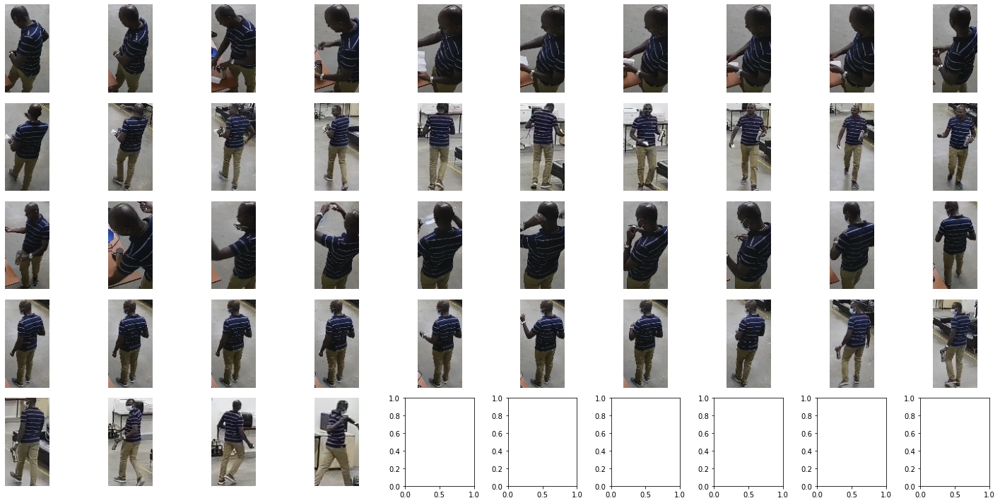

Track ID:  Q4LD


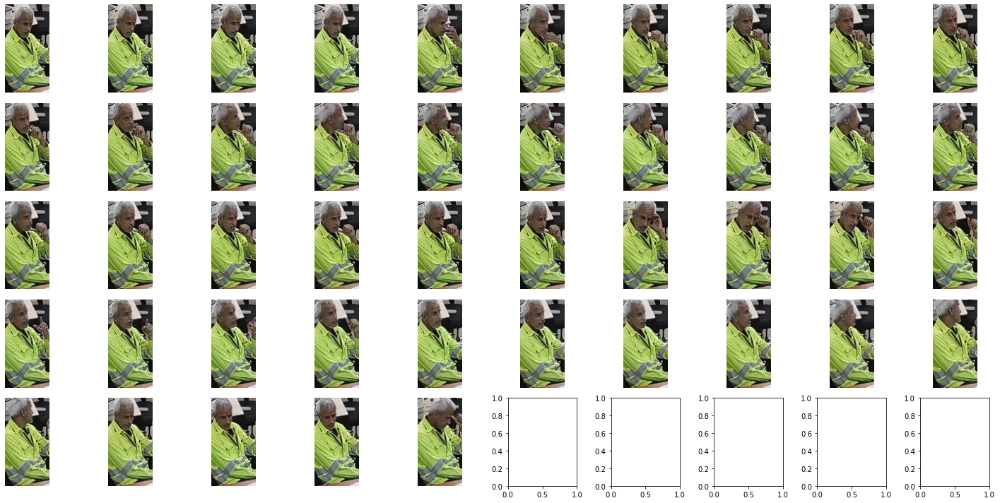

Track ID:  ERBU


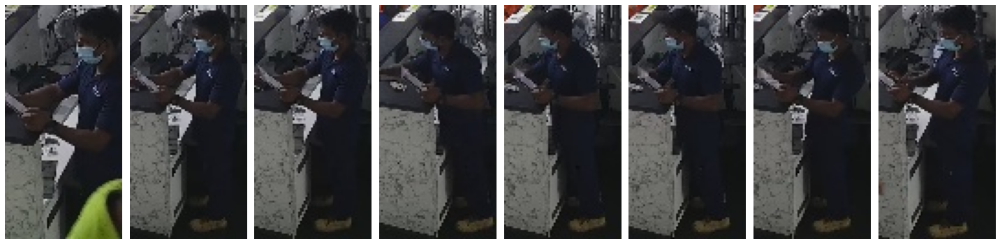

Track ID:  2L7F


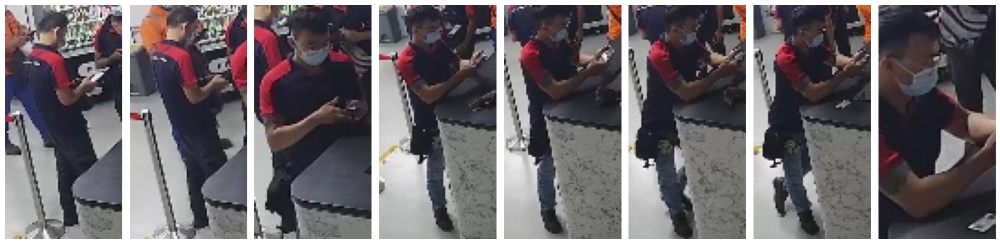

Track ID:  S5DL


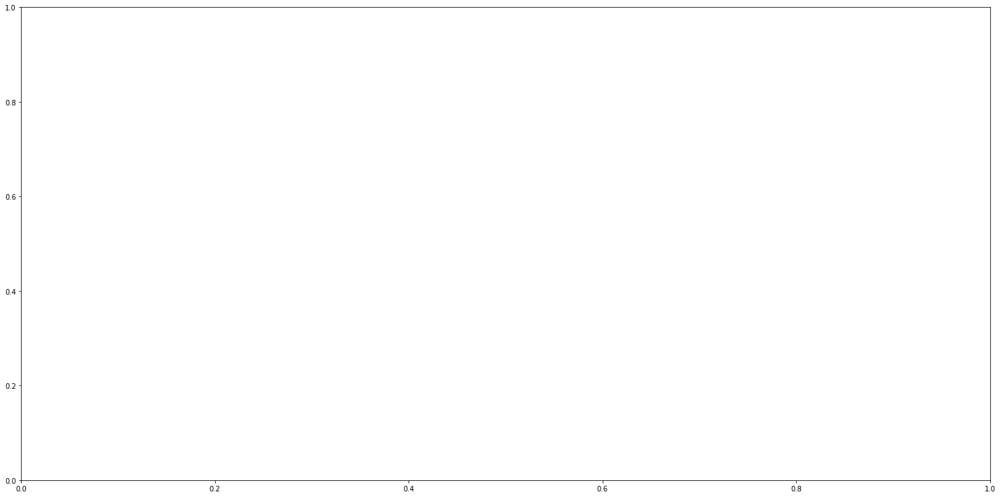

Track ID:  7UXF


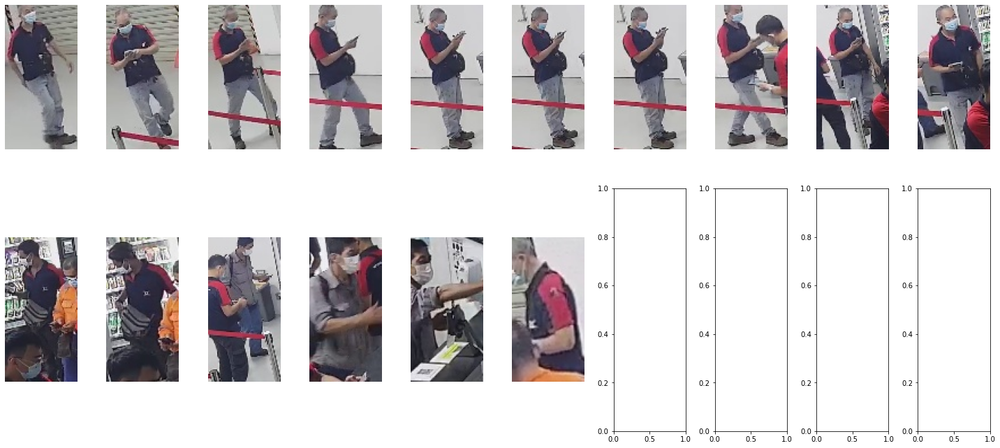

Track ID:  AG55


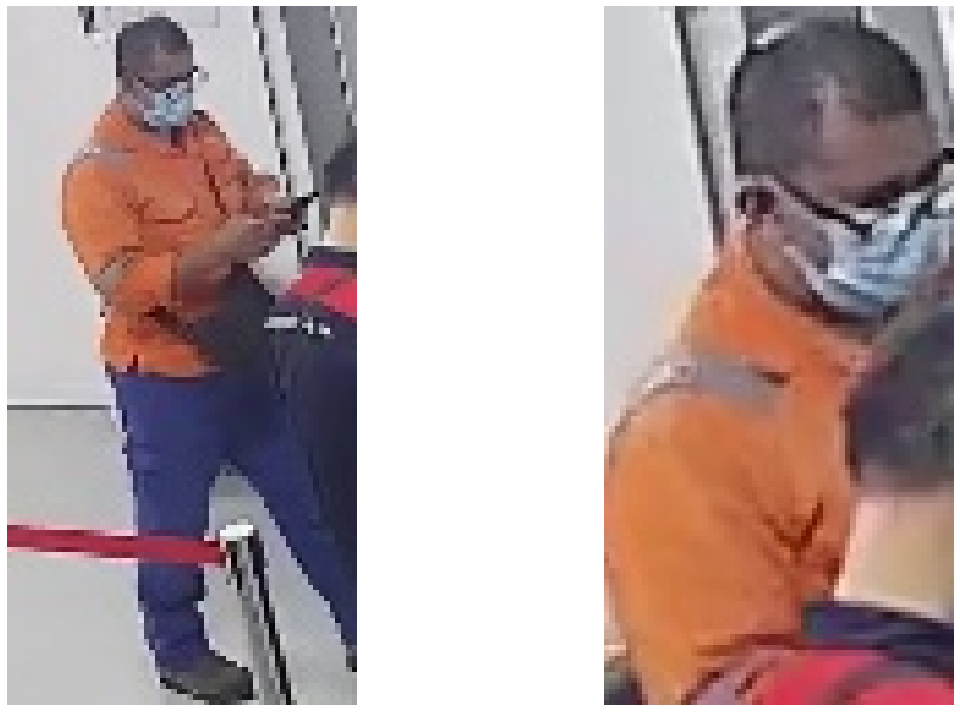

Track ID:  8NB0


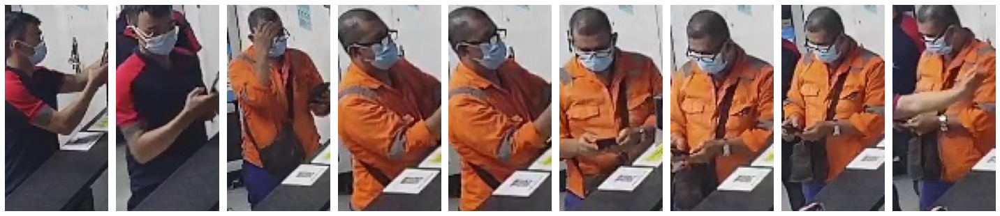

Track ID:  15XN


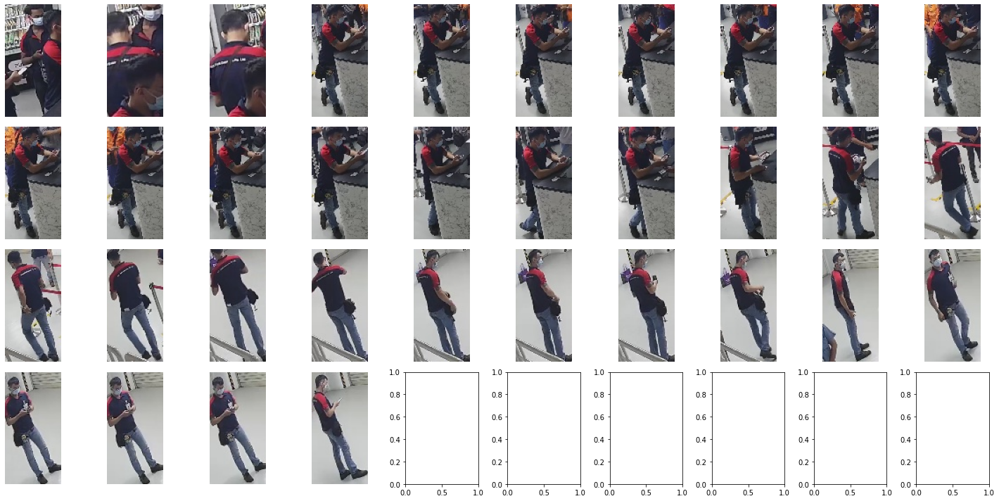

Track ID:  KS8G


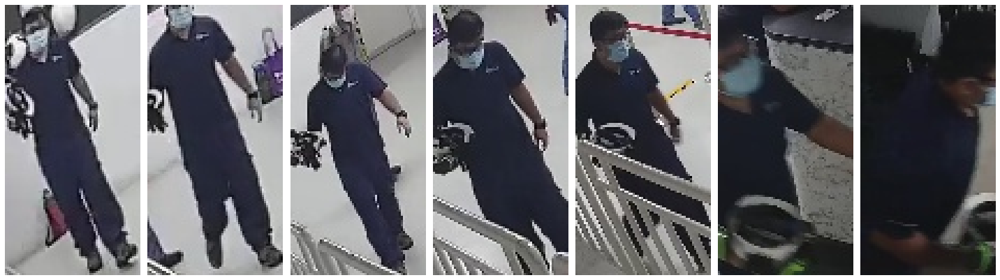

Track ID:  OQJ1


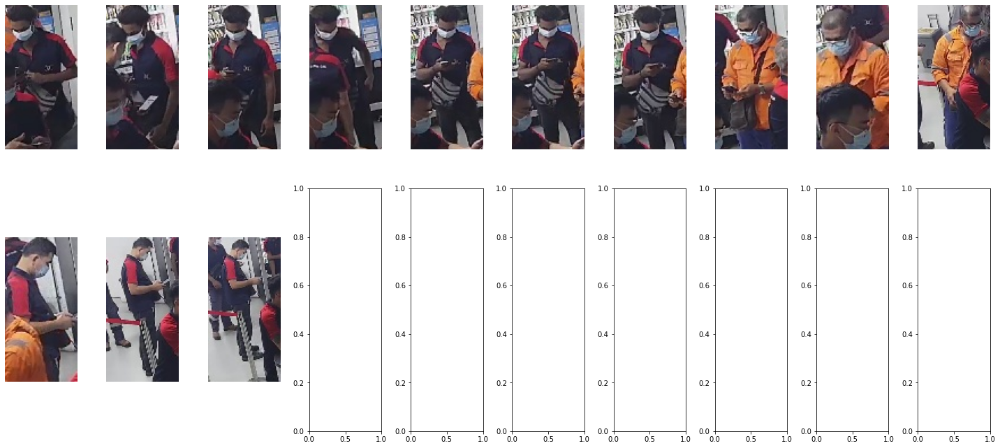

Track ID:  3YRZ


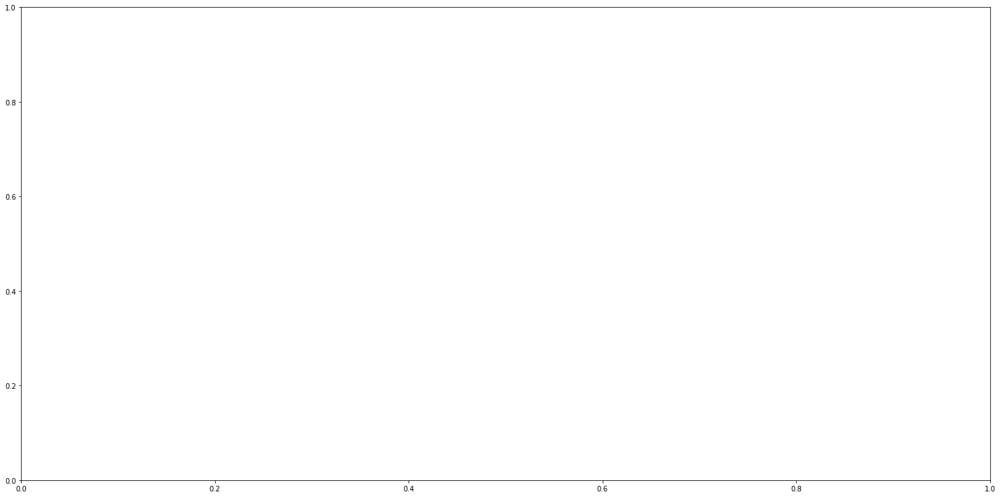

Track ID:  PI1M


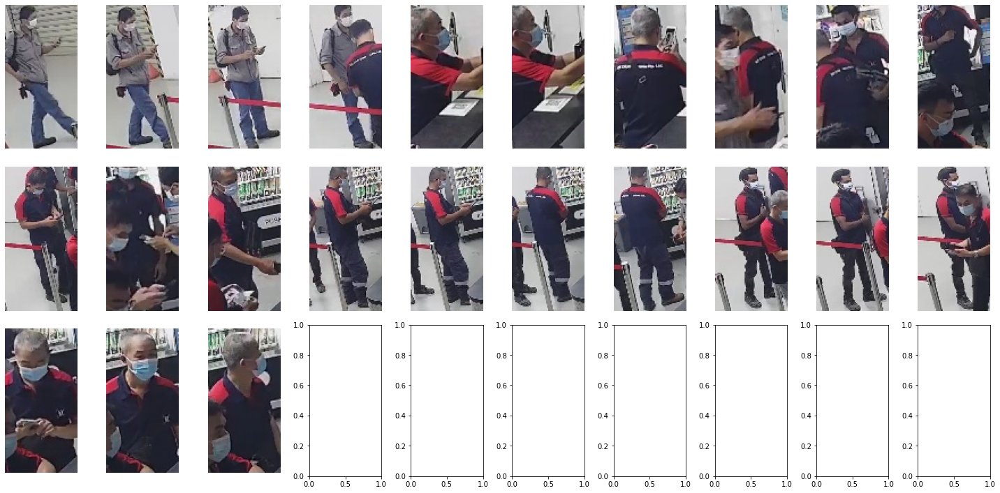

Track ID:  VY6G


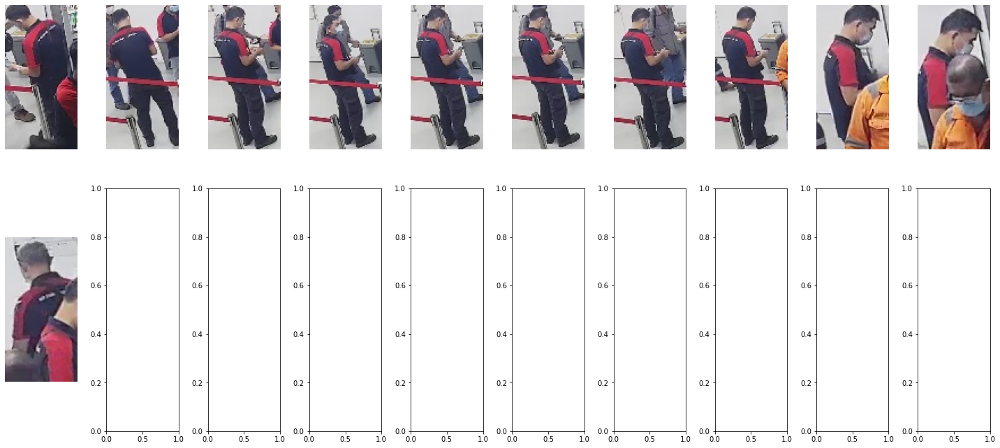

Track ID:  557N


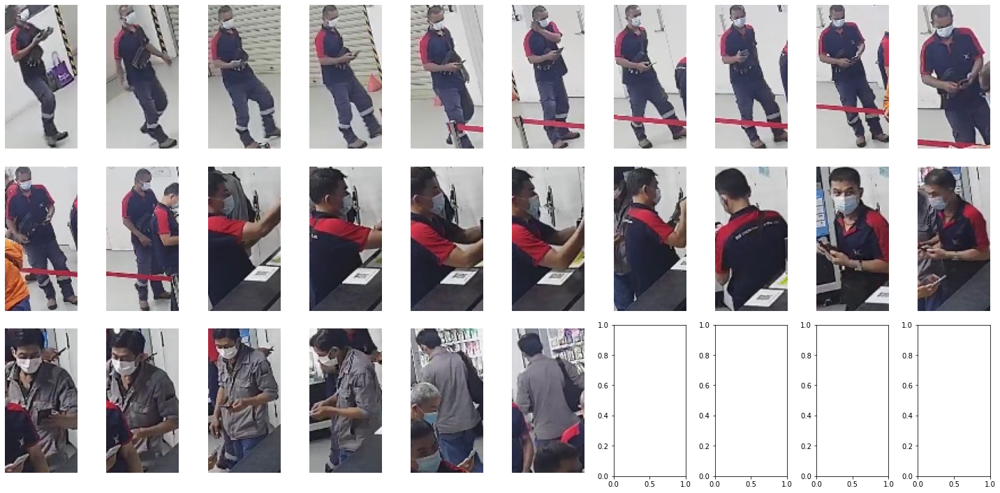

Track ID:  FC19


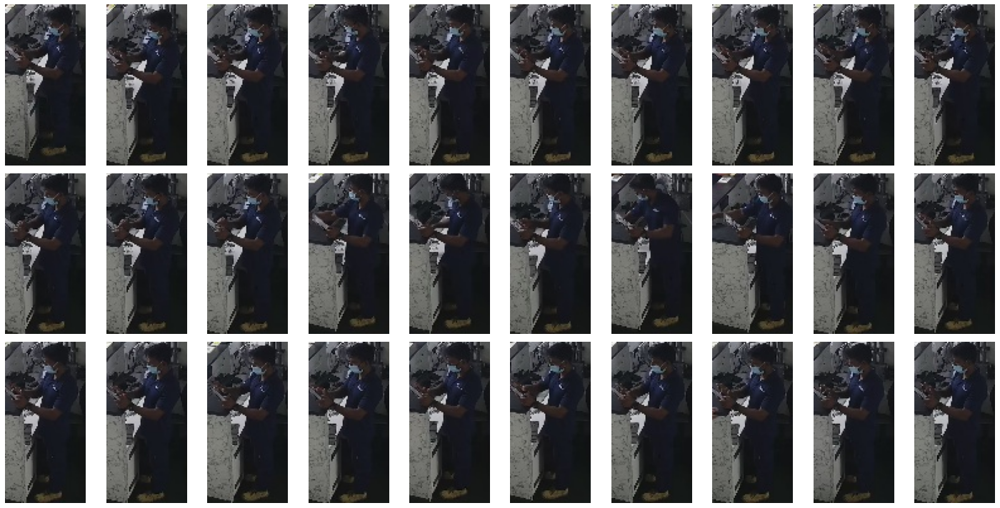

Track ID:  HNE4


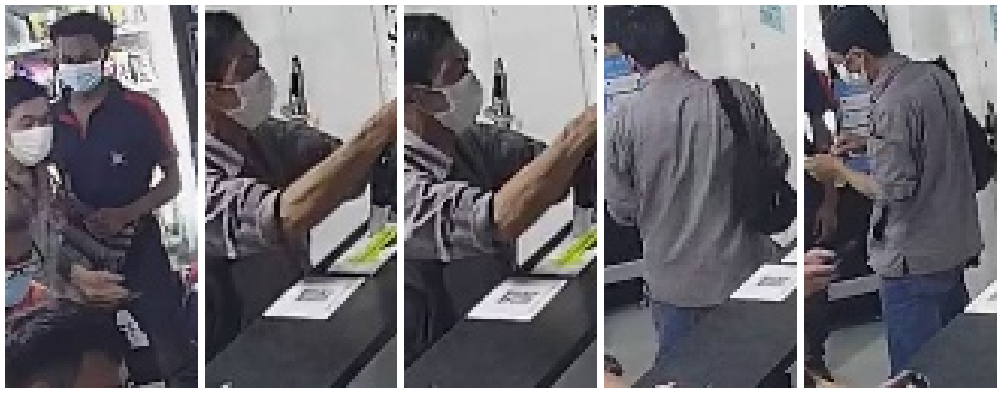

Track ID:  TWW4


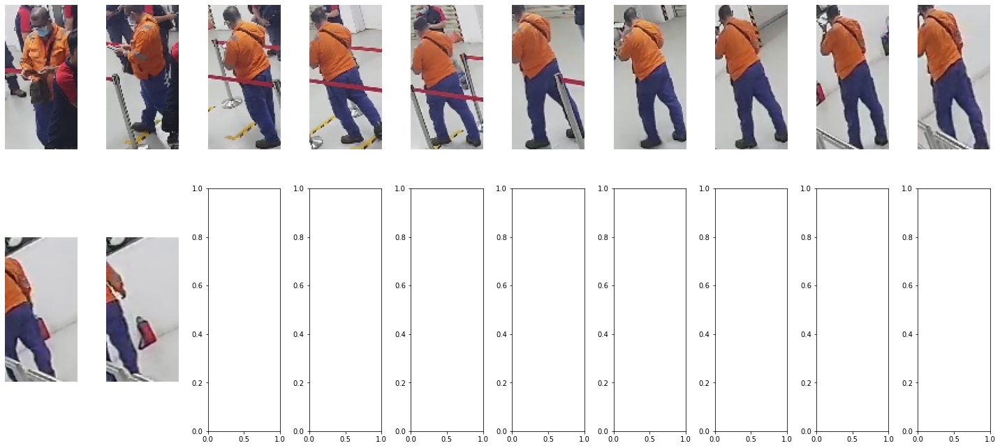

Track ID:  OE5X


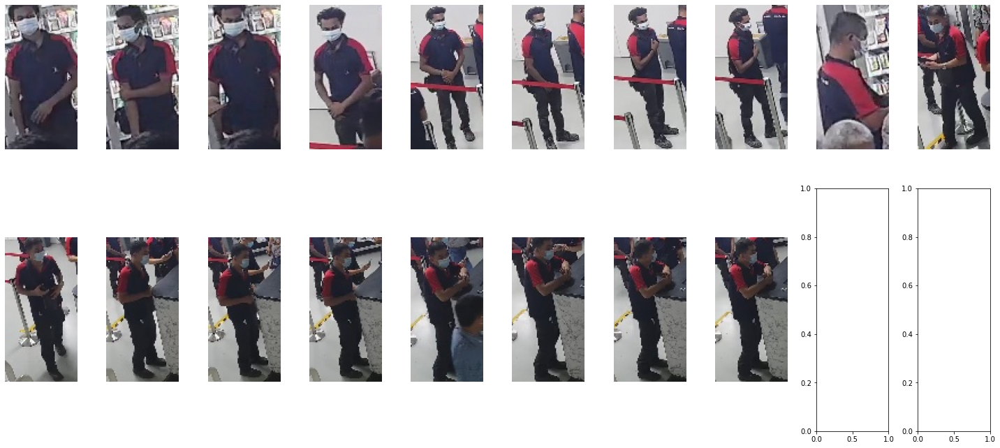

Track ID:  WW6F


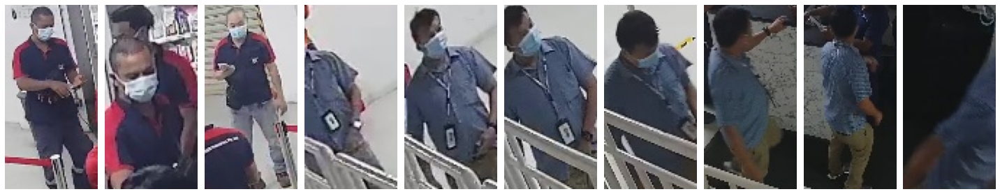

Track ID:  XKVX


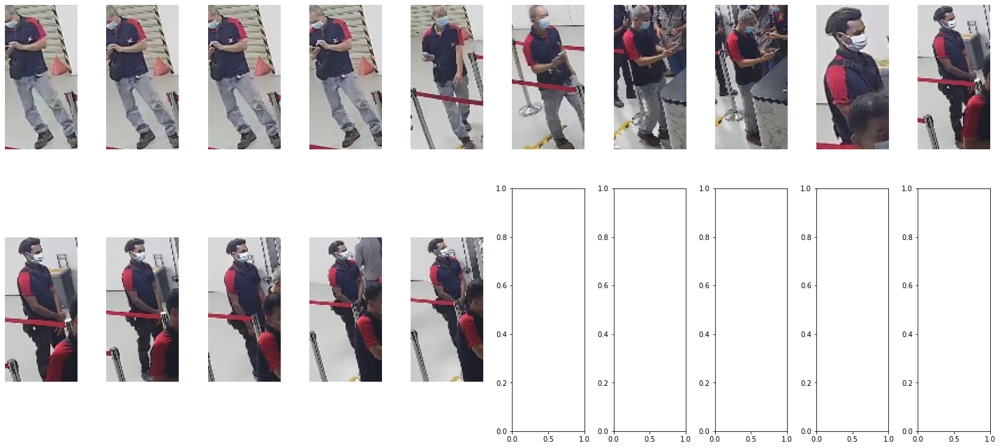

Track ID:  CB2D


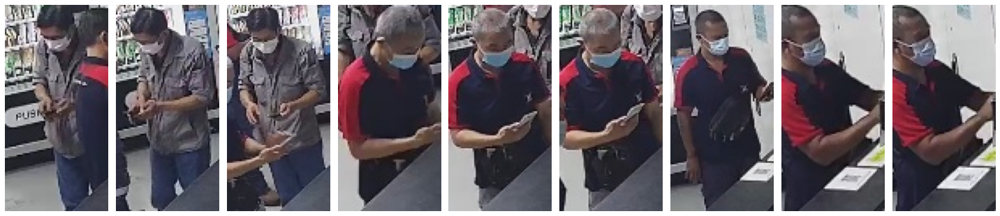

Track ID:  27CC


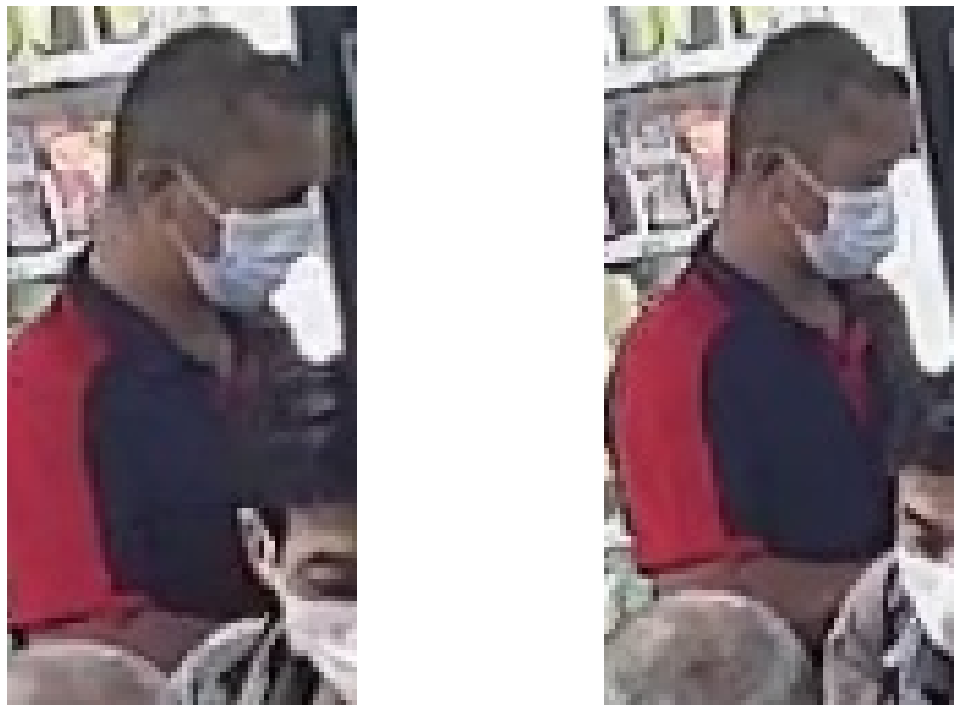

Track ID:  BUPL


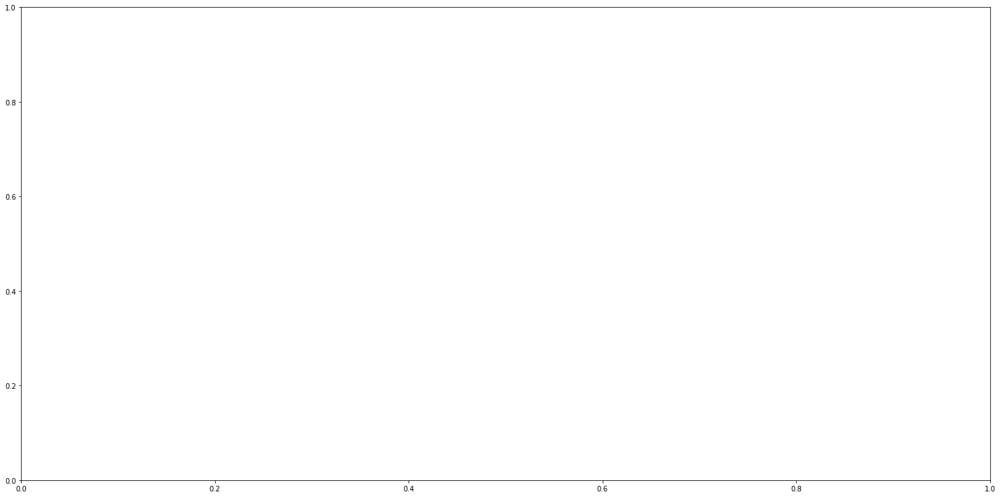

Track ID:  YPUF


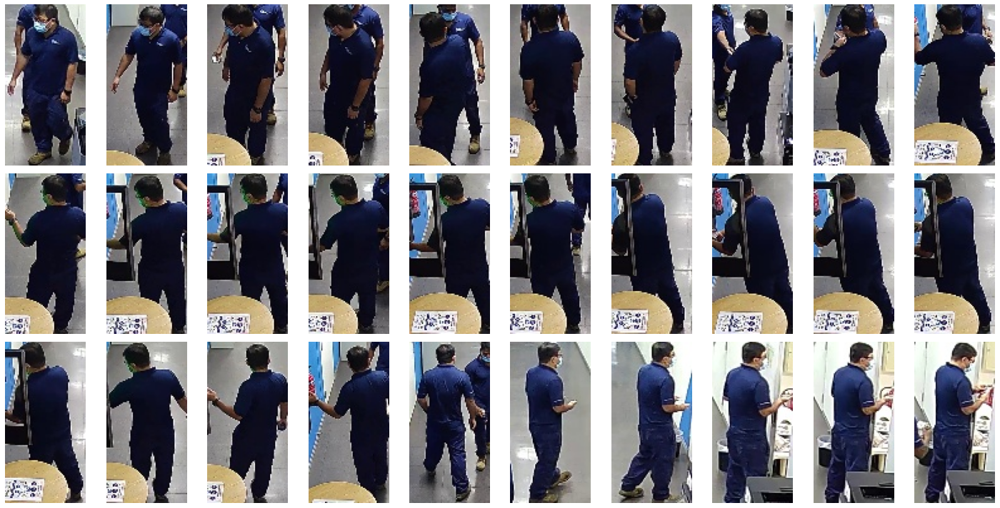

Track ID:  TFN9


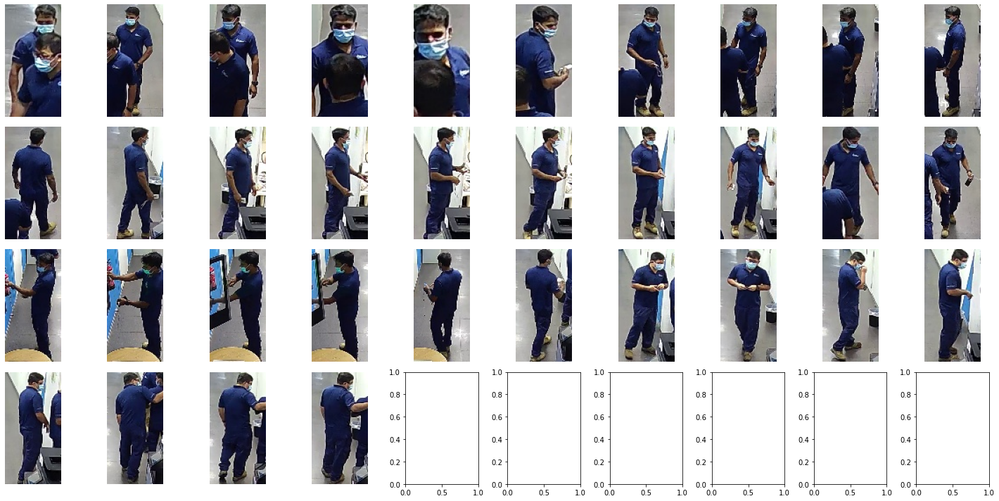

Track ID:  O5UN


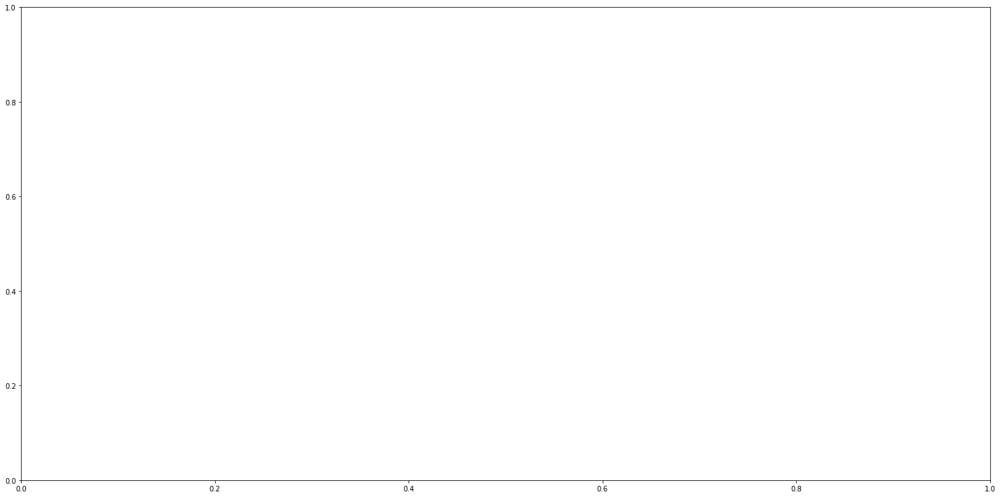

Track ID:  GG23


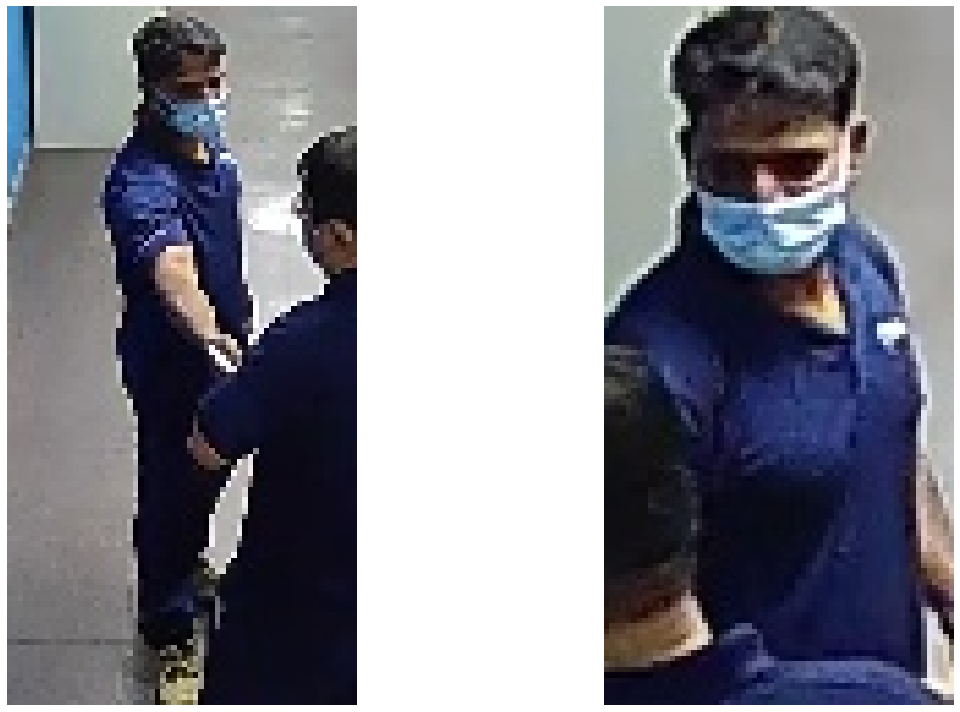

Track ID:  11WU


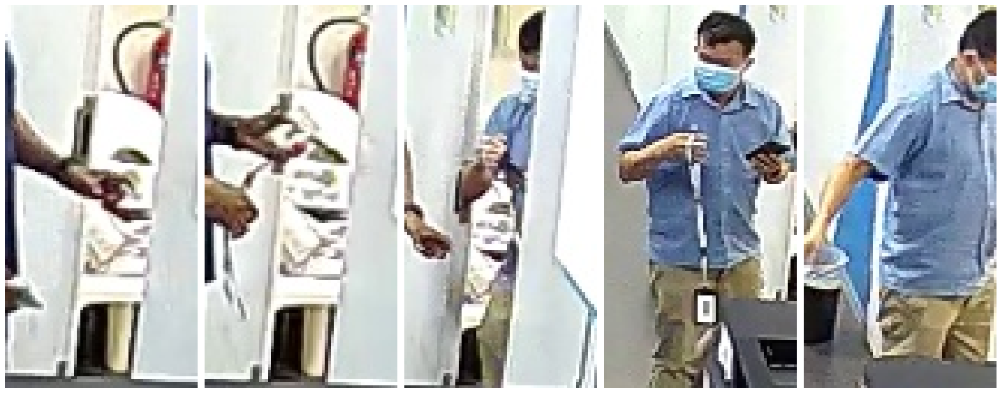

Track ID:  16IT


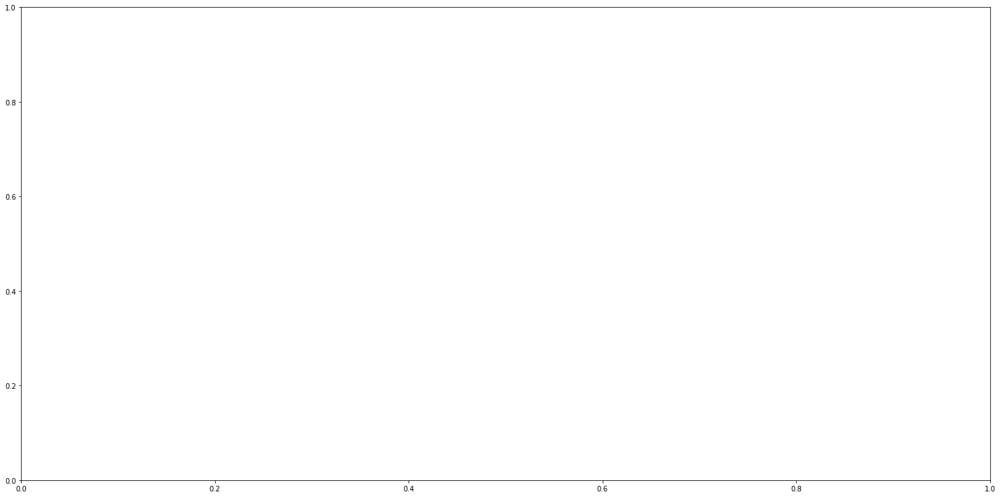

Track ID:  Y52O


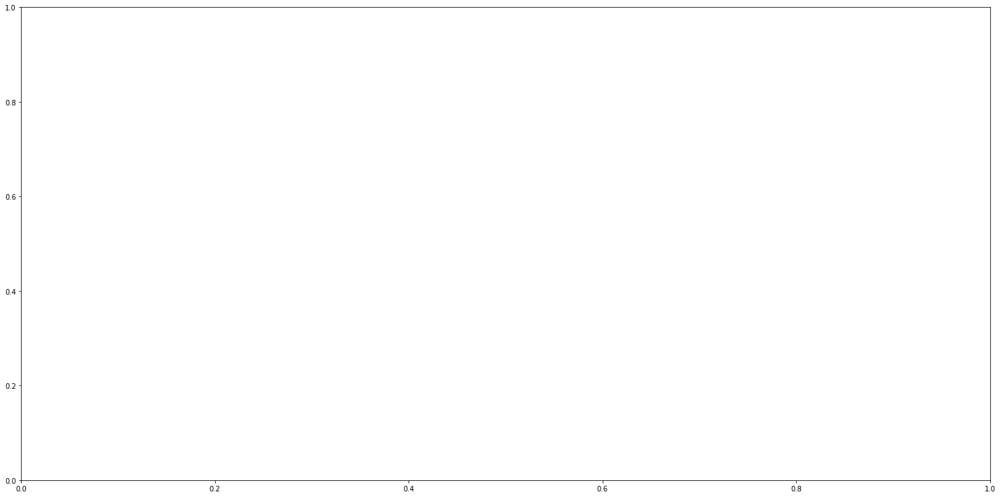

Track ID:  XO92


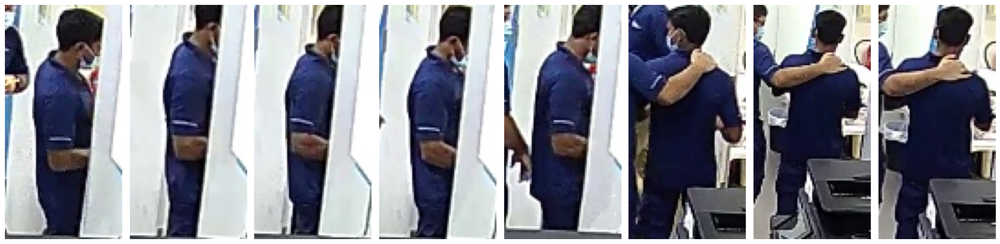

Track ID:  2C8H


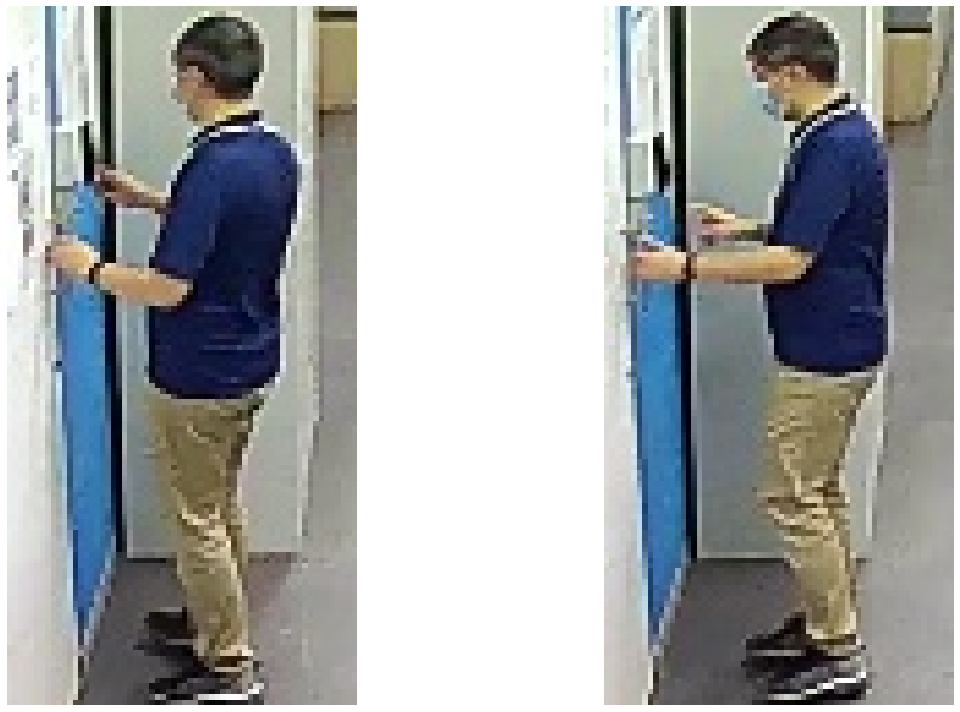

In [158]:
for track_id in list_track_ids:
    db_path = 'database/Image.db'
    table_name = 'VectorKB_Table'
    query = f"SELECT * FROM {table_name} WHERE track_id='{track_id}' ORDER BY track_id, timestamp LIMIT 100"
    conn = sqlite3.connect(db_path, detect_types=sqlite3.PARSE_DECLTYPES |
                        sqlite3.PARSE_COLNAMES)
    cursor = conn.cursor()
    cursor.execute(query)
    column_names = [desc[0] for desc in cursor.description]
    qry_results = pd.DataFrame(cursor.fetchall(), columns=column_names)
    #print(qry_results)
    img = cv2.imdecode(np.frombuffer(
        qry_results['patch_img'].iloc[0], np.uint8), cv2.IMREAD_ANYCOLOR)
    #print(type(img))
    print('Track ID: ', track_id)
    max_col = 10
    rows = math.ceil(len(qry_results) / max_col)
    if rows <= 1:
        cols = len(qry_results)
    else:
        cols = max_col
    fig, axs = plt.subplots(rows, cols, figsize=(20,10))
    for i in range(len(qry_results)):
        try:
            img_data = qry_results['patch_img'].iloc[i]
            img = cv2.imdecode(np.frombuffer(img_data, np.uint8), cv2.IMREAD_ANYCOLOR)
            if rows > 1:
                row = int(i / max_col)
                col = i % max_col
                axs[row, col].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
                axs[row, col].axis('off')
            else:
                axs[i].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
                axs[i].axis('off')
        except:
            pass
    fig.tight_layout()
    plt.show()


In [39]:
db_path = 'database/Image.db'
table_name = 'Inference_Table'
query = f'SELECT * FROM {table_name} LIMIT 1'
conn = sqlite3.connect(db_path, detect_types=sqlite3.PARSE_DECLTYPES |
                       sqlite3.PARSE_COLNAMES)
cursor = conn.cursor()
cursor.execute(query)
column_names = [desc[0] for desc in cursor.description]
qry_results = pd.DataFrame(cursor.fetchall(), columns=column_names)
print(qry_results)



Empty DataFrame
Columns: [img_id, cam_id, timestamp, track_id]
Index: []


In [40]:
db_path = 'database/reid_db.db'
query = "SELECT name FROM sqlite_master WHERE type='table'"
conn = sqlite3.connect(db_path, detect_types=sqlite3.PARSE_DECLTYPES |
                       sqlite3.PARSE_COLNAMES)
cursor = conn.cursor()
cursor.execute(query)
column_names = [desc[0] for desc in cursor.description]
qry_results = pd.DataFrame(cursor.fetchall(), columns=column_names)
print(qry_results)


              name
0  sqlite_sequence
1      human_table
2   vectorkb_table
3  inference_table


In [41]:
db_path = 'database/reid_db.db'
table_name = 'VectorKB_Table'
query = f'SELECT * FROM {table_name} LIMIT 1'
conn = sqlite3.connect(db_path, detect_types=sqlite3.PARSE_DECLTYPES |
                       sqlite3.PARSE_COLNAMES)
cursor = conn.cursor()
cursor.execute(query)
column_names = [desc[0] for desc in cursor.description]
qry_results = pd.DataFrame(cursor.fetchall(), columns=column_names)
print(qry_results)


                  img_id                                           img_path  \
0  -1_c1s1_000401_03.jpg  ../resource/market1501/bounding_box_test/-1_c1...   

                                                 img  \
0  b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00...   

                                       vector_tensor      create_datetime  
0  b'\x80\x03ctorch._utils\n_rebuild_tensor_v2\nq...  2021-04-02 16:06:22  


In [42]:
db_path = 'database/reid_db.db'
table_name = 'human_table'
query = f'SELECT * FROM {table_name} LIMIT 10'
conn = sqlite3.connect(db_path, detect_types=sqlite3.PARSE_DECLTYPES |
                       sqlite3.PARSE_COLNAMES)
cursor = conn.cursor()
cursor.execute(query)
column_names = [desc[0] for desc in cursor.description]
qry_results = pd.DataFrame(cursor.fetchall(), columns=column_names)
print(qry_results)


                  img_id human_id   inference_datetime
0  -1_c1s1_000401_03.jpg       -1  2021-04-05 14:57:13
1  -1_c1s1_000451_04.jpg       -1  2021-04-05 14:57:13
2  -1_c1s1_001351_04.jpg       -1  2021-04-05 14:57:13
3  -1_c1s1_001376_05.jpg       -1  2021-04-05 14:57:13
4  -1_c1s1_011251_02.jpg       -1  2021-04-05 14:57:13
5  -1_c1s1_011276_03.jpg       -1  2021-04-05 14:57:13
6  -1_c1s1_011426_05.jpg       -1  2021-04-05 14:57:13
7  -1_c1s1_011526_06.jpg       -1  2021-04-05 14:57:13
8  -1_c1s1_013476_02.jpg       -1  2021-04-05 14:57:13
9  -1_c1s1_014251_02.jpg       -1  2021-04-05 14:57:13


   inference_id             query_img_id query_img           match_1_img_id  \
0          3430  0001_c1s1_001051_00.jpg      None  0001_c1s1_001051_03.jpg   
1          3431  0001_c2s1_000301_00.jpg      None    -1_c2s1_000351_02.jpg   
2          3432  0001_c3s1_000551_00.jpg      None  0001_c3s1_000551_03.jpg   
3          3433  0001_c4s6_000810_00.jpg      None  0001_c4s6_000810_06.jpg   
4          3434  0001_c5s1_001426_00.jpg      None  0001_c5s1_001426_03.jpg   
5          3435  0001_c6s1_009601_00.jpg      None  0001_c6s1_009701_02.jpg   
6          3436  0003_c1s6_015971_00.jpg      None  0003_c1s6_015971_02.jpg   
7          3437  0003_c3s3_064744_00.jpg      None  0003_c3s3_064744_03.jpg   
8          3438  0003_c4s6_015641_00.jpg      None  0003_c4s6_015641_01.jpg   
9          3439  0003_c5s3_065187_00.jpg      None  0003_c5s3_065187_01.jpg   

                                         match_1_img  match_1_dist  \
0  b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00...      0.

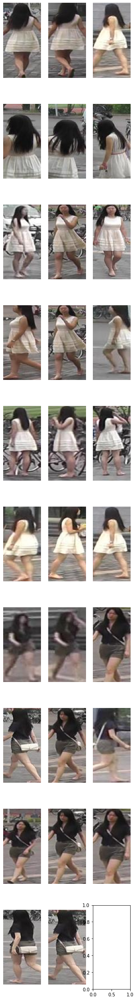

In [43]:
db_path = 'database/reid_db.db'
table_name = 'inference_table'
query = f'SELECT * FROM {table_name} LIMIT 10'
conn = sqlite3.connect(db_path, detect_types=sqlite3.PARSE_DECLTYPES |
                       sqlite3.PARSE_COLNAMES)
cursor = conn.cursor()
cursor.execute(query)
column_names = [desc[0] for desc in cursor.description]
qry_results = pd.DataFrame(cursor.fetchall(), columns=column_names)
print(qry_results)
print(type(qry_results['match_1_img'].iloc[0]))
img = cv2.imdecode(np.frombuffer(qry_results['match_1_img'].iloc[0], np.uint8), cv2.IMREAD_ANYCOLOR)
print(type(img), img.shape)
fig, axs = plt.subplots(len(qry_results), 3, figsize=(5, 40))
for i in range(len(qry_results)):
    for j in range(3):
        img_data = qry_results[f'match_{j+1}_img'].iloc[i]
        if img_data is not None:
            img = cv2.imdecode(np.frombuffer(img_data, np.uint8), cv2.IMREAD_ANYCOLOR)
            axs[i,j].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
            axs[i,j].axis('off')
plt.show()


In [44]:
db_path = 'database/reid_db.db'
table_name = 'sqlite_sequence'
query = f'SELECT * FROM {table_name}'
conn = sqlite3.connect(db_path, detect_types=sqlite3.PARSE_DECLTYPES |
                       sqlite3.PARSE_COLNAMES)
cursor = conn.cursor()
cursor.execute(query)
column_names = [desc[0] for desc in cursor.description]
qry_results = pd.DataFrame(cursor.fetchall(), columns=column_names)
print(qry_results)


              name   seq
0  inference_table  7887


In [93]:
%load_ext autoreload
%autoreload 2
from src.database.database import DbQuery

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [46]:
imagedb = DbQuery(db_path='database/Image.db')
query = "SELECT name FROM sqlite_master WHERE type='table'"
qry_results = imagedb.query_data(query)
print(qry_results)

              name
0   VectorKB_Table
1  Inference_Table


Index(['img_id', 'cam_id', 'timestamp', 'track_id', 'patch_img', 'patch_np',
       'patch_bbox', 'frame_num'],
      dtype='object')
<class 'numpy.ndarray'> uint8


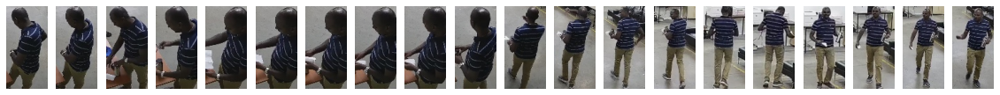

In [68]:
query = 'SELECT * FROM VectorKB_Table ORDER BY cam_id, img_id LIMIT 20'
qry_results = imagedb.query_data(query)
print(qry_results.columns)
img = cv2.imdecode(np.frombuffer(
    qry_results['patch_img'].iloc[0], np.uint8), cv2.IMREAD_ANYCOLOR)
print(type(img), img.dtype)
fig, axs = plt.subplots(1, len(qry_results), figsize=(20, 15))
for i in range(len(qry_results)):
    img_data = qry_results['patch_img'].iloc[i]
    img = cv2.imdecode(np.frombuffer(
        img_data, np.uint8), cv2.IMREAD_ANYCOLOR)
    axs[i].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    axs[i].axis('off')
plt.show()


In [48]:
query = 'SELECT * FROM Inference_Table LIMIT 1'
qry_results = imagedb.query_data(query)
print(qry_results)


Empty DataFrame
Columns: [img_id, cam_id, timestamp, track_id]
Index: []


In [49]:
reiddb = DbQuery(db_path='database/reid_db.db')
query = "SELECT name FROM sqlite_master WHERE type='table'"
qry_results = reiddb.query_data(query)
print(qry_results)


              name
0  sqlite_sequence
1      human_table
2   vectorkb_table
3  inference_table


Index(['img_id', 'img_path', 'img', 'vector_tensor', 'create_datetime'], dtype='object')
<class 'bytes'>
<class 'numpy.ndarray'> (128, 64, 3)


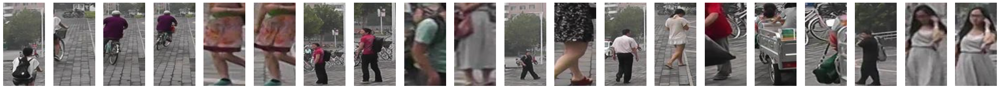

In [50]:
query = 'SELECT * FROM vectorkb_table ORDER BY img_id LIMIT 20'
qry_results = reiddb.query_data(query)
print(qry_results.columns)
print(type(qry_results['img'].iloc[0]))
img = cv2.imdecode(np.frombuffer(
    qry_results['img'].iloc[0], np.uint8), cv2.IMREAD_ANYCOLOR)
print(type(img), img.shape)
fig, axs = plt.subplots(1, len(qry_results), figsize=(40, 40))
for i in range(len(qry_results)):
    img_data = qry_results[f'img'].iloc[i]
    if img_data is not None:
        img = cv2.imdecode(np.frombuffer(
            img_data, np.uint8), cv2.IMREAD_ANYCOLOR)
        axs[i].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        axs[i].axis('off')
plt.show()


In [ ]:
query = 'SELECT * FROM human_table LIMIT 10'
qry_results = reiddb.query_data(query)
print(qry_results)


                  img_id human_id   inference_datetime
0  -1_c1s1_000401_03.jpg       -1  2021-04-05 14:57:13
1  -1_c1s1_000451_04.jpg       -1  2021-04-05 14:57:13
2  -1_c1s1_001351_04.jpg       -1  2021-04-05 14:57:13
3  -1_c1s1_001376_05.jpg       -1  2021-04-05 14:57:13
4  -1_c1s1_011251_02.jpg       -1  2021-04-05 14:57:13
5  -1_c1s1_011276_03.jpg       -1  2021-04-05 14:57:13
6  -1_c1s1_011426_05.jpg       -1  2021-04-05 14:57:13
7  -1_c1s1_011526_06.jpg       -1  2021-04-05 14:57:13
8  -1_c1s1_013476_02.jpg       -1  2021-04-05 14:57:13
9  -1_c1s1_014251_02.jpg       -1  2021-04-05 14:57:13


Index(['inference_id', 'query_img_id', 'query_img', 'match_1_img_id',
       'match_1_img', 'match_1_dist', 'match_2_img_id', 'match_2_img',
       'match_2_dist', 'match_3_img_id', 'match_3_img', 'match_3_dist',
       'inference_datetime'],
      dtype='object')
<class 'bytes'>
<class 'numpy.ndarray'> (128, 64, 3)


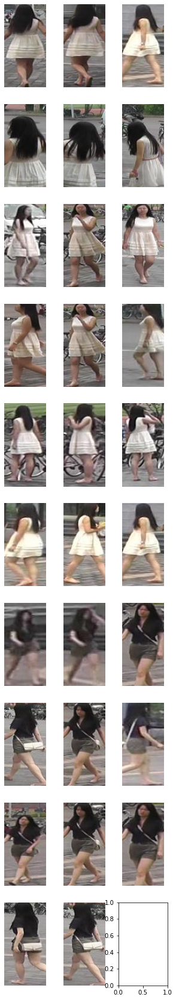

In [ ]:
query = 'SELECT * FROM inference_table LIMIT 10'
qry_results = reiddb.query_data(query)
print(qry_results.columns)
print(type(qry_results['match_1_img'].iloc[0]))
img = cv2.imdecode(np.frombuffer(
    qry_results['match_1_img'].iloc[0], np.uint8), cv2.IMREAD_ANYCOLOR)
print(type(img), img.shape)
fig, axs = plt.subplots(len(qry_results), 3, figsize=(5, 30))
for i in range(len(qry_results)):
    for j in range(3):
        img_data = qry_results[f'match_{j+1}_img'].iloc[i]
        if img_data is not None:
            img = cv2.imdecode(np.frombuffer(
                img_data, np.uint8), cv2.IMREAD_ANYCOLOR)
            axs[i, j].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
            axs[i, j].axis('off')
plt.show()


In [81]:
query = 'SELECT DISTINCT(human_id) FROM human_table'
qry_results = reiddb.query_data(query)
print(qry_results)


    human_id
0         -1
1       0000
2       0001
3       0003
4       0004
..       ...
751     1501
752     1502
753     1503
754     1504
755     1505

[756 rows x 1 columns]


[autoreload of src.demo_dash.query_re_id failed: Traceback (most recent call last):
  File "C:\Users\mokky\.conda\envs\pose37\lib\site-packages\IPython\extensions\autoreload.py", line 245, in check
    superreload(m, reload, self.old_objects)
  File "C:\Users\mokky\.conda\envs\pose37\lib\site-packages\IPython\extensions\autoreload.py", line 410, in superreload
    update_generic(old_obj, new_obj)
  File "C:\Users\mokky\.conda\envs\pose37\lib\site-packages\IPython\extensions\autoreload.py", line 347, in update_generic
    update(a, b)
  File "C:\Users\mokky\.conda\envs\pose37\lib\site-packages\IPython\extensions\autoreload.py", line 302, in update_class
    if update_generic(old_obj, new_obj): continue
  File "C:\Users\mokky\.conda\envs\pose37\lib\site-packages\IPython\extensions\autoreload.py", line 347, in update_generic
    update(a, b)
  File "C:\Users\mokky\.conda\envs\pose37\lib\site-packages\IPython\extensions\autoreload.py", line 266, in update_function
    setattr(old, name, ge

In [97]:
query = "SELECT * FROM human_table WHERE human_id == '0003'"
qry_results = reiddb.query_data(query)
print(qry_results)


                     img_id human_id   inference_datetime
0   0003_c1s6_015971_02.jpg     0003  2021-04-05 14:57:33
1   0003_c1s6_015996_02.jpg     0003  2021-04-05 14:57:33
2   0003_c3s3_064744_03.jpg     0003  2021-04-05 14:57:33
3   0003_c3s3_064794_04.jpg     0003  2021-04-05 14:57:33
4   0003_c4s6_015641_01.jpg     0003  2021-04-05 14:57:33
5   0003_c4s6_015666_02.jpg     0003  2021-04-05 14:57:33
6   0003_c4s6_015716_03.jpg     0003  2021-04-05 14:57:33
7   0003_c5s3_065187_01.jpg     0003  2021-04-05 14:57:33
8   0003_c6s3_088392_04.jpg     0003  2021-04-05 14:57:33
9   0003_c6s3_088442_04.jpg     0003  2021-04-05 14:57:33
10  0003_c1s6_015971_00.jpg     0003  2021-04-05 15:18:30
11  0003_c3s3_064744_00.jpg     0003  2021-04-05 15:18:30
12  0003_c4s6_015641_00.jpg     0003  2021-04-05 15:18:30
13  0003_c5s3_065187_00.jpg     0003  2021-04-05 15:18:30
14  0003_c6s3_088392_00.jpg     0003  2021-04-05 15:18:30


In [94]:
from src.demo_dash import query_image, query_re_id
dbreid = query_re_id.DbQuery()
print(dbreid.get_human_id_options())


[{'label': '-1', 'value': '-1'}, {'label': '0000', 'value': '0000'}, {'label': '0001', 'value': '0001'}, {'label': '0003', 'value': '0003'}, {'label': '0004', 'value': '0004'}, {'label': '0005', 'value': '0005'}, {'label': '0006', 'value': '0006'}, {'label': '0008', 'value': '0008'}, {'label': '0009', 'value': '0009'}, {'label': '0013', 'value': '0013'}, {'label': '0014', 'value': '0014'}, {'label': '0015', 'value': '0015'}, {'label': '0016', 'value': '0016'}, {'label': '0017', 'value': '0017'}, {'label': '0018', 'value': '0018'}, {'label': '0019', 'value': '0019'}, {'label': '0021', 'value': '0021'}, {'label': '0024', 'value': '0024'}, {'label': '0025', 'value': '0025'}, {'label': '0026', 'value': '0026'}, {'label': '0029', 'value': '0029'}, {'label': '0031', 'value': '0031'}, {'label': '0033', 'value': '0033'}, {'label': '0034', 'value': '0034'}, {'label': '0036', 'value': '0036'}, {'label': '0038', 'value': '0038'}, {'label': '0039', 'value': '0039'}, {'label': '0040', 'value': '004

In [95]:
dbreid.get_images(-1)


AttributeError: 'DbQuery' object has no attribute 'get_images'